# Stopping times in adaptive trials
This notebooks explores what happens when we combine stopping times with adaptive algorithms

In [2]:
# Imports & preperation code
%load_ext autoreload
%autoreload 2

import numpy
from adaptive_nof1.models import Model, SelfExperimentationModel
from adaptive_nof1.basic_types import Outcome, History

from adaptive_nof1 import SeriesOfSimulationsRunner, SeriesOfSimulationsData
from adaptive_nof1.policies import (
    FixedPolicy,
    ThompsonSampling,
    BalancedThompsonSampling,
    ClippedThompsonSampling,
    ComposedPolicy,
    StoppingPolicy,
)
from adaptive_nof1.inference import (
    BetaModel,
    ConjugateNormalModel,
)
from adaptive_nof1.helpers import *
from adaptive_nof1.series_of_simulations_runner import simulate_configurations
from adaptive_nof1.metrics import SimpleRegret, RegretAgainstOtherConfiguration
import matplotlib.pyplot as plt
import holoviews
import pandas

WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


## Methodology

We will use a simple simulation model, and explore the effects of different stopping "techniques".

## Simulation Model
We assume ordinal outcomes between 0 and 5 for our simulation model.
It is assumed that this ordinal measure is achieved by mapping a continuous outcome onto 5 point scale. The decision boundaries are chosen by dividing the probability mass of a $N(0,1)$ distribution into equal parts. They are -0.84, -0.25, 0.25 and 0.84.
In the most basic case, the outcome is defined as: $outcome(a) = baseline + \text{effect}(a)$.

## Policies
We start with three policies for comparison:
- Fixed, Balanced Design
- Thompson Sampling with Beta Model
- Thompson Sampling with Conjugate Normal Model

## Evaluation
We evaluate different metrics that could be interesting:  
Regret is defined as the difference in the sum of outcomes between to policies. For our case, we want to compare against the fixed schedule.
We define the regret as  
$Regret(policy) = \sum_{t}^T Reward(t)_{fixed} - \sum_{t}^T Reward(t)_{adaptive}$.

We evaluate:
- Regret, including 0.25 and 0.75 quantiles
- Best Intervention Identification


In [3]:
# Code for setting priors
conjugate_normal_model_priors = {
    "mean": 2.5,
    "l": 0.5,
    "alpha": 10,
    "beta": 10,
}

In [4]:
# Code for calculating evaluation
def calculate_recommendations(calculated_series):
    data = []
    for result in calculated_series:
        series_of_simulations_data = result["result"]
        for simulation in series_of_simulations_data.simulations:
            observation = simulation.history.observations[-1]
            if "probabilities" in observation.debug_data:
                # print(observation.debug_data["probabilities"])
                probabilities = observation.debug_data["probabilities"]
                data.append(
                    {
                        **simulation.configuration,
                        "p_assigned_intervention_1": probabilities[1],
                        "p_assigned_intervention_0": probabilities[0],
                        "recommendation": numpy.argmax(probabilities),
                    }
                )
                # print(data)
            else:
                df = simulation.history.to_df()
                data.append(
                    {
                        **simulation.configuration,
                        "recommendation": numpy.argmax(
                            df.groupby("treatment")["outcome"].mean()
                        ),
                    }
                )
    recommended_interventions_df = pandas.DataFrame(data)
    return recommended_interventions_df


def generate_result_table(calculated_series):
    # Things for the table: mean regret, median regret, 25% regret, 75% regret, bias when fitting linear regression model
    metrics = [
        RegretAgainstOtherConfiguration(
            configuration_transform_function=switch_config,
            config_to_simulation_data=config_to_simulation_data,
            outcome_name="outcome",
        ),
    ]
    series = [entry["result"] for entry in calculated_series]
    scores = SeriesOfSimulationsData.score_data(
        series,
        metrics,
    )
    scores = scores[scores["t"] == scores["t"].max()]
    table = pandas.DataFrame()
    table["mean_regret"] = scores.groupby(["policy", "model"])["score"].mean()
    table["median_regret"] = scores.groupby(["policy", "model"])["score"].median()
    table[".25 quantile regret"] = scores.groupby(["policy", "model"])[
        "score"
    ].quantile(0.25)
    table[".75 quantile regret"] = scores.groupby(["policy", "model"])[
        "score"
    ].quantile(0.75)
    table[".95 quantile regret"] = scores.groupby(["policy", "model"])[
        "score"
    ].quantile(0.95)
    table[".05 quantile regret"] = scores.groupby(["policy", "model"])[
        "score"
    ].quantile(0.05)
    table["Span of regret"] = (
        scores.groupby(["policy", "model"])["score"].max()
        - scores.groupby(["policy", "model"])["score"].min()
    )
    recommended_interventions_df = calculate_recommendations(calculated_series)
    table["p_assigned_intervention_1_mean"] = recommended_interventions_df.groupby(
        ["policy", "model"]
    )["p_assigned_intervention_1"].mean()
    table["recommendation_mean"] = recommended_interventions_df.groupby(
        ["policy", "model"]
    )["recommendation"].mean()
    return table.swaplevel("policy", "model").sort_index()

In [5]:
# Prepare simulation constants
N_INTERVENTIONS = 2
LENGTH = 40
N_PATIENTS = 10
ALPHA_STOPPING = 0.10

## Scenario 1:
Let's start with a simple scenario: $baseline \sim Normal(0, 1)$, Treatment effects differ.
We look at 3 different effects:
- Scenario 1.1: -1 // Treatment worsens outcome
- Scenario 1.2: 0  // Treatment does not change outcome
- Scenario 1.3: 1  // Treatment improves outcome

In [6]:
# Define models
data_generating_model_1_1 = lambda patient_id: SelfExperimentationModel(
    patient_id,
    intervention_effects=[0, -1],
    baseline_model="noise",
    baseline_config={"variance": 1},
)
data_generating_model_1_2 = lambda patient_id: SelfExperimentationModel(
    patient_id,
    intervention_effects=[0, 0],
    baseline_model="noise",
    baseline_config={"variance": 1},
)
data_generating_model_1_3 = lambda patient_id: SelfExperimentationModel(
    patient_id,
    intervention_effects=[0, 1],
    baseline_model="noise",
    baseline_config={"variance": 1},
)

In [7]:
# Define policies


def alpha_stopping_time_conjugate(history, context):
    model = ConjugateNormalModel(**conjugate_normal_model_priors)
    model.update_posterior(history, N_INTERVENTIONS)
    probabilities = model.approximate_max_probabilities(N_INTERVENTIONS, context)
    return 1 - max(probabilities) < ALPHA_STOPPING


def alpha_stopping_time_beta(history, context):
    model = BetaModel()
    model.update_posterior(history, N_INTERVENTIONS)
    probabilities = model.approximate_max_probabilities(N_INTERVENTIONS, context)
    return 1 - max(probabilities) < ALPHA_STOPPING


fixed_policy = StoppingPolicy(
    policy=FixedPolicy(number_of_actions=N_INTERVENTIONS),
    stopping_time=alpha_stopping_time_conjugate,
)
linear_ts = StoppingPolicy(
    ThompsonSampling(
        inference_model=ConjugateNormalModel(**conjugate_normal_model_priors),
        number_of_actions=N_INTERVENTIONS,
    ),
    stopping_time=alpha_stopping_time_conjugate,
)
beta_ts = StoppingPolicy(
    ThompsonSampling(
        inference_model=BetaModel(),
        number_of_actions=N_INTERVENTIONS,
    ),
    stopping_time=alpha_stopping_time_beta,
)

In [8]:
# Full crossover study
study_designs = {
    "n_patients": [N_PATIENTS],
    "policy": [fixed_policy, linear_ts, beta_ts],
    "model_from_patient_id": [
        data_generating_model_1_1,
        data_generating_model_1_2,
        data_generating_model_1_3,
    ],
}
configurations = generate_configuration_cross_product(study_designs)

In [9]:
calculated_series, config_to_simulation_data = simulate_configurations(
    configurations, LENGTH
)

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

In [10]:
def plot_allocations_for_calculated_series(calculated_series):
    panels = [series["result"].plot_allocations() for series in calculated_series]
    for panel, i in zip(panels, range(len(panels))):
        panel.opts(
            title=f"{calculated_series[i]['configuration']['policy']}, {calculated_series[i]['configuration']['model']}",
            fontsize={"title": "80%"},
        )
    return holoviews.Layout(panels).cols(1)


plot_allocations_for_calculated_series(calculated_series)

/opt/homebrew/Caskroom/miniconda/base/envs/mt/lib/python3.11/site-packages/holoviews/plotting/bokeh/plot.py:987: UserWarning: found multiple competing values for 'toolbar.active_drag' property; using the latest value
  layout_plot = gridplot(
/opt/homebrew/Caskroom/miniconda/base/envs/mt/lib/python3.11/site-packages/holoviews/plotting/bokeh/plot.py:987: UserWarning: found multiple competing values for 'toolbar.active_scroll' property; using the latest value
  layout_plot = gridplot(


:Layout
   .HeatMap.I    :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,debug_data,treatment)
   .HeatMap.II   :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,debug_data,treatment)
   .HeatMap.III  :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,debug_data,treatment)
   .HeatMap.IV   :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,debug_data,treatment)
   .HeatMap.V    :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,debug_data,treatment)
   .HeatMap.VI   :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,debug_data,treatment)
   .HeatMap.VII  :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,debug_data,treatment)
   .HeatMap.VIII :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,debug_data,treatment)
   .HeatMap.IX   :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,debug_data,treatment)

In [11]:
metrics = [
    SimpleRegret(
        outcome_name="outcome",
    ),
]
series = [entry["result"] for entry in calculated_series]
scores = SeriesOfSimulationsData.score_data(
    series,
    metrics,
)

AssertionError: Simple Regret can only be calculated if the expectations of interventions are known

In [ ]:
scores

# Find the index of rows with the maximum 't' value for each patient
max_t_indices = scores.groupby(["policy", "metric", "model"])["t"].idxmax()

# Select rows using the indices
result_df = scores.loc[max_t_indices]
df = result_df.groupby(["policy", "metric", "model"])[["score", "t"]].mean()
df["score/t"] = df["score"] / df["t"]
df

In [96]:
data_generating_model_3_1 = lambda patient_id: SelfExperimentationModel(
    patient_id, intervention_effects=[0, 1], correlation=0.3
)
data_generating_model_3_2 = lambda patient_id: SelfExperimentationModel(
    patient_id, intervention_effects=[0, 1], correlation=-0.3
)
data_generating_model_3_3 = lambda patient_id: SelfExperimentationModel(
    patient_id, intervention_effects=[0, 1], correlation=0.7
)
data_generating_model_3_4 = lambda patient_id: SelfExperimentationModel(
    patient_id, intervention_effects=[0, 1], correlation=-0.7
)
data_generating_model_3_5 = lambda patient_id: SelfExperimentationModel(
    patient_id, intervention_effects=[0, 0], correlation=-0.7
)
data_generating_model_3_6 = lambda patient_id: SelfExperimentationModel(
    patient_id, intervention_effects=[0, 0], correlation=-0.7
)

In [21]:
study_designs = {
    "n_patients": [N_PATIENTS],
    "policy": [fixed_policy, linear_ts, beta_ts],
    "model_from_patient_id": [
        data_generating_model_3_1,
        data_generating_model_3_2,
        data_generating_model_3_3,
        data_generating_model_3_4,
        data_generating_model_3_5,
        data_generating_model_3_6,
    ],
}
configurations = generate_configuration_cross_product(study_designs)

In [22]:
# Takes some time
calculated_series, config_to_simulation_data = simulate_configurations(
    configurations, LENGTH
)

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

<Axes: xlabel='t'>

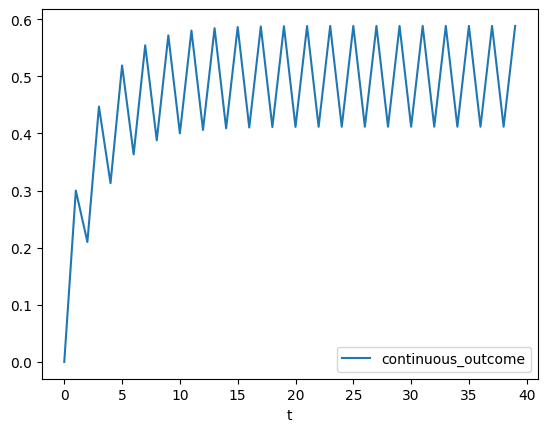

In [23]:
# Let's plot an outcome to see it's correlation:
calculated_series[2]["result"].simulations[0].history.to_df().plot(
    x="t", y="continuous_outcome"
)

In [24]:
generate_result_table(calculated_series)

mean_regret  \
model                  policy                                                
SEM[[0, 0], , -0.7, 0] FixedPolicy                                    0.00   
                       ThompsonSampling(BetaModel)                    0.00   
                       ThompsonSampling(ConjugateNormalModel)         0.00   
SEM[[0, 1], , -0.3, 0] FixedPolicy                                    0.00   
                       ThompsonSampling(BetaModel)                  -54.79   
                       ThompsonSampling(ConjugateNormalModel)       -54.81   
SEM[[0, 1], , -0.7, 0] FixedPolicy                                    0.00   
                       ThompsonSampling(BetaModel)                  -63.06   
                       ThompsonSampling(ConjugateNormalModel)       -68.25   
SEM[[0, 1], , 0.3, 0]  FixedPolicy                                    0.00   
                       ThompsonSampling(BetaModel)                  -53.32   
                       ThompsonSampling(ConjugateNormalModel)       -52.31   
SEM[[0, 1], , 0.7, 0]  FixedPolicy                                    0.00   
                       ThompsonSampling(BetaModel)                  -21.13   
                       ThompsonSampling(ConjugateNormalModel)       -21.71   

                                                               median_regret  \
model                  policy                                                  
SEM[[0, 0], , -0.7, 0] FixedPolicy                                       0.0   
                       ThompsonSampling(BetaModel)                       0.0   
                       ThompsonSampling(ConjugateNormalModel)            0.0   
SEM[[0, 1], , -0.3, 0] FixedPolicy                                       0.0   
                       ThompsonSampling(BetaModel)                     -55.0   
                       ThompsonSampling(ConjugateNormalModel)          -55.0   
SEM[[0, 1], , -0.7, 0] FixedPolicy                                       0.0   
                       ThompsonSampling(BetaModel)                     -63.0   
                       ThompsonSampling(ConjugateNormalModel)          -69.0   
SEM[[0, 1], , 0.3, 0]  FixedPolicy                                       0.0   
                       ThompsonSampling(BetaModel)                     -54.0   
                       ThompsonSampling(ConjugateNormalModel)          -52.0   
SEM[[0, 1], , 0.7, 0]  FixedPolicy                                       0.0   
                       ThompsonSampling(BetaModel)                     -23.0   
                       ThompsonSampling(ConjugateNormalModel)          -26.0   

                                                               .25 quantile regret  \
model                  policy                                                        
SEM[[0, 0], , -0.7, 0] FixedPolicy                                            0.00   
                       ThompsonSampling(BetaModel)                            0.00   
                       ThompsonSampling(ConjugateNormalModel)                 0.00   
SEM[[0, 1], , -0.3, 0] FixedPolicy                                            0.00   
                       ThompsonSampling(BetaModel)                          -56.00   
                       ThompsonSampling(ConjugateNormalModel)               -56.00   
SEM[[0, 1], , -0.7, 0] FixedPolicy                                            0.00   
                       ThompsonSampling(BetaModel)                          -67.00   
                       ThompsonSampling(ConjugateNormalModel)               -70.00   
SEM[[0, 1], , 0.3, 0]  FixedPolicy                                            0.00   
                       ThompsonSampling(BetaModel)                          -55.00   
                       ThompsonSampling(ConjugateNormalModel)               -53.25   
SEM[[0, 1], , 0.7, 0]  FixedPolicy                                            0.00   
                       ThompsonSampling(BetaModel)                          -27.25   

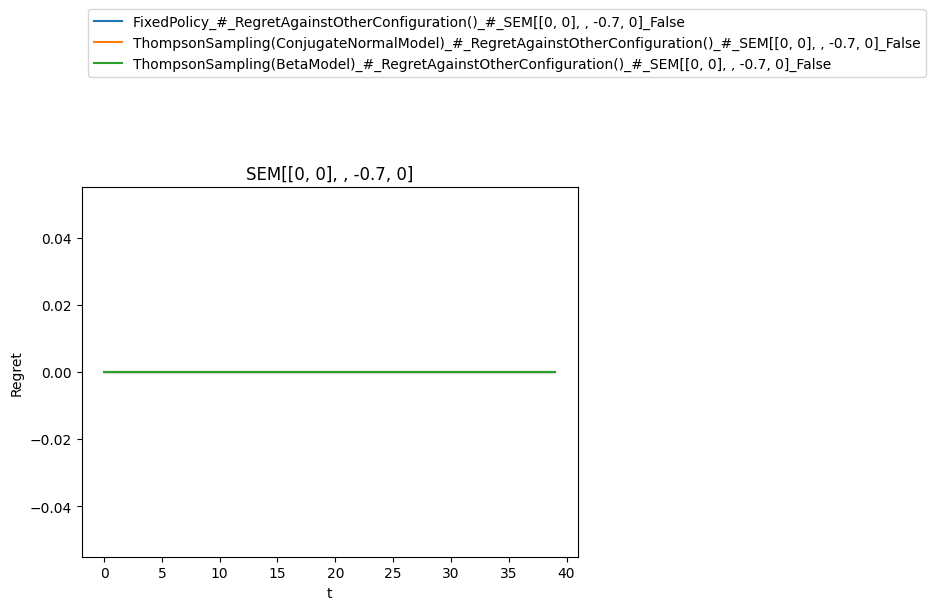

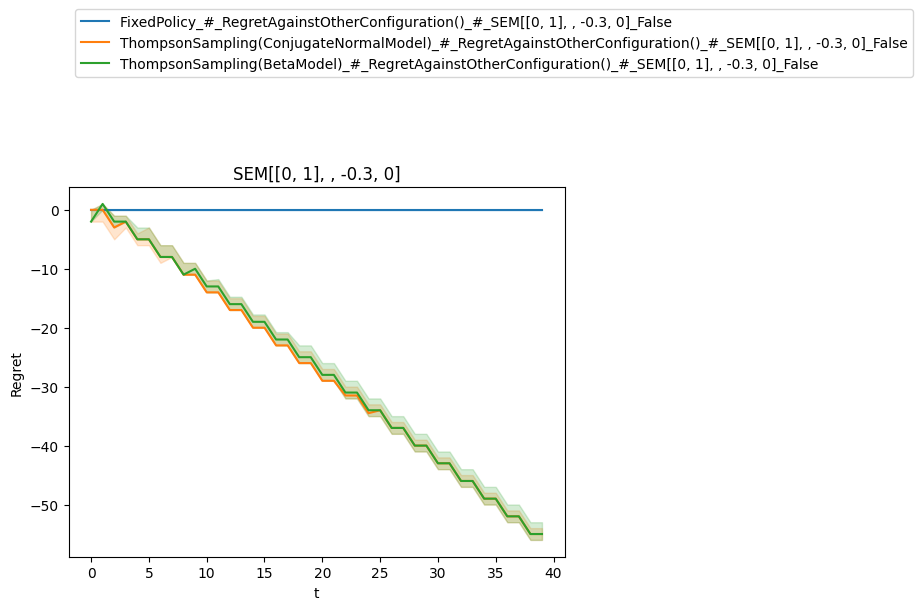

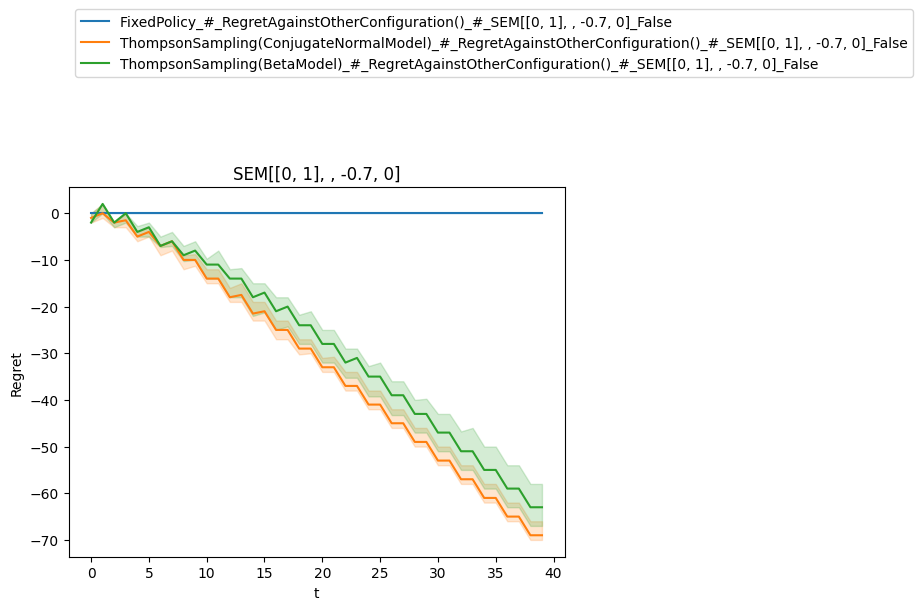

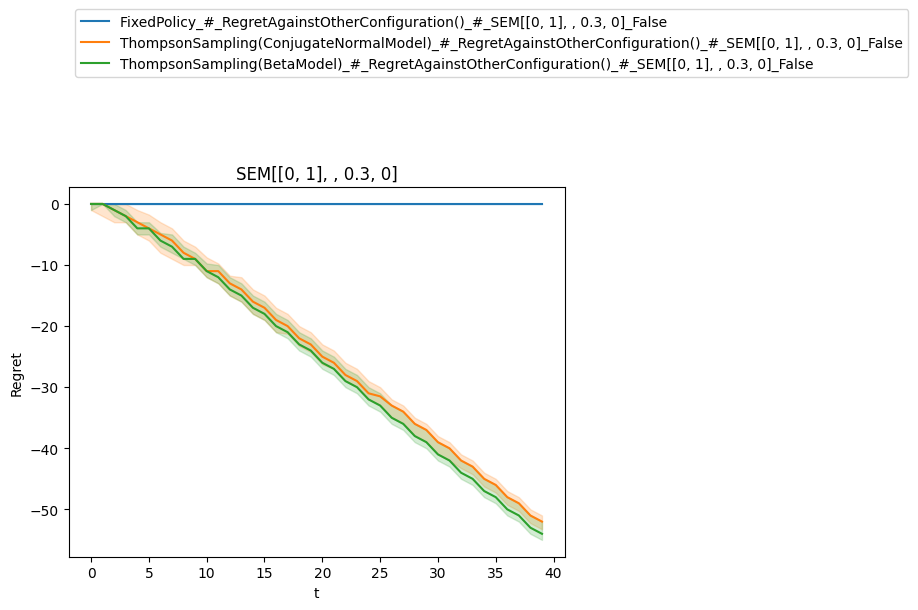

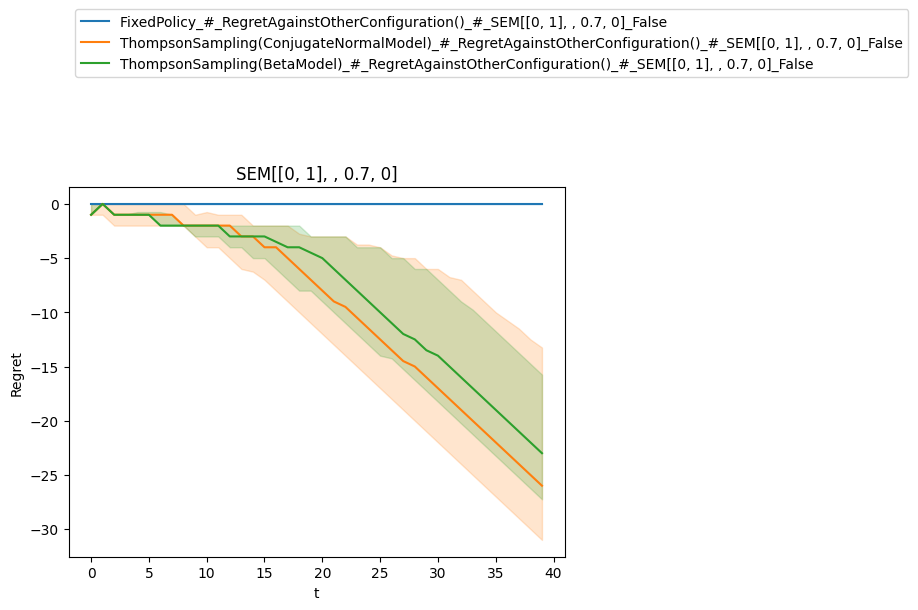

In [25]:
plot_regret_against_fixed(calculated_series, config_to_simulation_data)

In [26]:
plot_allocations_for_calculated_series(calculated_series)

/opt/homebrew/Caskroom/miniconda/base/envs/mt/lib/python3.11/site-packages/holoviews/plotting/bokeh/plot.py:987: UserWarning: found multiple competing values for 'toolbar.active_drag' property; using the latest value
  layout_plot = gridplot(
/opt/homebrew/Caskroom/miniconda/base/envs/mt/lib/python3.11/site-packages/holoviews/plotting/bokeh/plot.py:987: UserWarning: found multiple competing values for 'toolbar.active_scroll' property; using the latest value
  layout_plot = gridplot(


:Layout
   .HeatMap.I     :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.II    :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.III   :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.IV    :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.V     :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.VI    :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.VII   :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.VIII  :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.IX    :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.X     :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.XI    :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.XII   :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.XIII  :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.XIV   :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.XV    :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.XVI   :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.XVII  :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)
   .HeatMap.XVIII :HeatMap   [t,patient_id]   (treatment,debug_info,context,outcome,counterfactual_outcomes,treatment)

### Result 
- The results in regret differ, which should not be because the models perform better but because we change the simulation environment. No sever bad effects can be seen by the different correlation factors.

### Identified problems:
None